In [1]:
import torch
import os, json, cv2, random
from google.colab.patches import cv2_imshow

In [2]:
torch.__version__ 

'1.10.0+cu111'

In [3]:
! nvcc --version 

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0


In [4]:
! pip install detectron2 -f \
  https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 27.3 MB/s 
     |████████████████████████████████| 74 kB 3.0 MB/s 
     |████████████████████████████████| 145 kB 24.7 MB/s 
     |████████████████████████████████| 49 kB 6.1 MB/s 
     |████████████████████████████████| 130 kB 48.5 MB/s 
     |████████████████████████████████| 749 kB 52.3 MB/s 
     |████████████████████████████████| 843 kB 35.5 MB/s 
     |████████████████████████████████| 596 kB 52.3 MB/s 
     |████████████████████████████████| 112 kB 51.9 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20211023-py3-none-any.whl size=60947 sha256=ae368d2ee69ffeea3b6844820b7e278701579ccdde5de53aa72a54dbccdb34ef
  Stored in directory: /root/.cache/pip/wheels/16/98/fc/252d62cab6263c719120e06b28f3378af59b52ce7a20e81852
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=9a

In [8]:
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
import os
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

## Download VOC tar 


In [3]:
!wget http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar

--2021-11-23 20:52:01--  http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar
Resolving host.robots.ox.ac.uk (host.robots.ox.ac.uk)... 129.67.94.152
Connecting to host.robots.ox.ac.uk (host.robots.ox.ac.uk)|129.67.94.152|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 460032000 (439M) [application/x-tar]
Saving to: ‘VOCtrainval_06-Nov-2007.tar’

VOCtrainval_06-Nov- 100%[===================>] 438.72M   189MB/s    in 2.3s    

2021-11-23 20:52:04 (189 MB/s) - ‘VOCtrainval_06-Nov-2007.tar’ saved [460032000/460032000]



## Extract the VOC data 

In [4]:
%%capture
!tar -xvf VOCtrainval_06-Nov-2007.tar

## Rename folder to datasets 

In [5]:
!mv VOCdevkit datasets

## Get Detectrons Config object

In [9]:
cfg_fastrcnn = get_cfg()
cfg_fastrcnn.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

## Set Hyper-Parameters

In [10]:
cfg_fastrcnn.OUTPUT_DIR = 'MyVOCTraining'
cfg_fastrcnn.DATASETS.TRAIN = ("voc_2007_train",)
cfg_fastrcnn.DATASETS.TEST = ()
cfg_fastrcnn.DATALOADER.NUM_WORKERS = 4
cfg_fastrcnn.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml") # Let training initialize from model zoo
cfg_fastrcnn.SOLVER.IMS_PER_BATCH = 1
cfg_fastrcnn.SOLVER.BASE_LR = 0.00025 # pick a good LR
cfg_fastrcnn.SOLVER.MAX_ITER = 3000
cfg_fastrcnn.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg_fastrcnn.MODEL.ROI_HEADS.NUM_CLASSES = 20

## Train the model

In [11]:
os.makedirs(cfg_fastrcnn.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg_fastrcnn) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/23 21:00:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
model_final_280758.pkl: 167MB [00:16, 10.3MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (21, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (21,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor

[11/23 21:00:25 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-p

[11/23 21:00:38 d2.utils.events]:  eta: 0:30:33  iter: 19  total_loss: 3.905  loss_cls: 2.976  loss_box_reg: 0.9077  loss_rpn_cls: 0.01703  loss_rpn_loc: 0.01344  time: 0.6050  data_time: 0.0211  lr: 4.9953e-06  max_mem: 1504M
[11/23 21:00:49 d2.utils.events]:  eta: 0:28:39  iter: 39  total_loss: 3.742  loss_cls: 2.932  loss_box_reg: 0.7566  loss_rpn_cls: 0.004186  loss_rpn_loc: 0.008548  time: 0.5822  data_time: 0.0034  lr: 9.9902e-06  max_mem: 1526M
[11/23 21:01:01 d2.utils.events]:  eta: 0:28:26  iter: 59  total_loss: 3.64  loss_cls: 2.713  loss_box_reg: 0.8973  loss_rpn_cls: 0.009824  loss_rpn_loc: 0.01692  time: 0.5805  data_time: 0.0042  lr: 1.4985e-05  max_mem: 1526M
[11/23 21:01:12 d2.utils.events]:  eta: 0:28:10  iter: 79  total_loss: 3.458  loss_cls: 2.471  loss_box_reg: 0.9232  loss_rpn_cls: 0.01623  loss_rpn_loc: 0.009865  time: 0.5768  data_time: 0.0041  lr: 1.998e-05  max_mem: 1526M
[11/23 21:01:23 d2.utils.events]:  eta: 0:27:58  iter: 99  total_loss: 2.74  loss_cls: 2.0

### Load weights onto predictor

In [12]:
cfg_fastrcnn.MODEL.WEIGHTS = os.path.join(cfg_fastrcnn.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg_fastrcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg_fastrcnn)

Save output DIR to Drive

In [22]:
cp -r MyVOCTraining /content/drive/MyDrive/CV/HW6

Load tensorboard logs

In [31]:
%load_ext tensorboard
%tensorboard --logdir MyVOCTraining/


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Run Inference on the trained model

In [ ]:
from detectron2.evaluation import PascalVOCDetectionEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = PascalVOCDetectionEvaluator("voc_2007_val")
val_loader = build_detection_test_loader(cfg_fastrcnn, "voc_2007_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator)['bbox']['AP50'])


[11/22 23:01:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/22 23:01:09 d2.data.common]: Serializing 2510 elements to byte tensors and concatenating them all ...
[11/22 23:01:09 d2.data.common]: Serialized dataset takes 1.14 MiB
[11/22 23:01:09 d2.evaluation.evaluator]: Start inference on 2510 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[11/22 23:01:13 d2.evaluation.evaluator]: Inference done 11/2510. Dataloading: 0.0017 s/iter. Inference: 0.3468 s/iter. Eval: 0.0003 s/iter. Total: 0.3488 s/iter. ETA=0:14:31
[11/22 23:01:18 d2.evaluation.evaluator]: Inference done 26/2510. Dataloading: 0.0026 s/iter. Inference: 0.3435 s/iter. Eval: 0.0003 s/iter. Total: 0.3466 s/iter. ETA=0:14:20
[11/22 23:01:24 d2.evaluation.evaluator]: Inference done 42/2510. Dataloading: 0.0026 s/iter. Inference: 0.3374 s/iter. Eval: 0.0003 s/iter. Total: 0.3404 s/iter. ETA=0:14:00
[11/22 23:01:29 d2.evaluation.evaluator]: Inference done 58/2510. Dataloading: 0.0026 s/iter. Inference: 0.3332 s/iter. Eval: 0.0003 s/iter. Total: 0.3362 s/iter. ETA=0:13:44
[11/22 23:01:34 d2.evaluation.evaluator]: Inference done 74/2510. Dataloading: 0.0027 s/iter. Inference: 0.3322 s/iter. Eval: 0.0003 s/iter. Total: 0.3354 s/iter. ETA=0:13:36
[11/22 23:01:39 d2.evaluation.evaluator]: Inference done 89/2510. Dataloading: 0.0027 s/iter. Inference: 0.3332 s/iter. Eval:

## Visualize Predictions

------------------------------------------------------------------------------------------


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


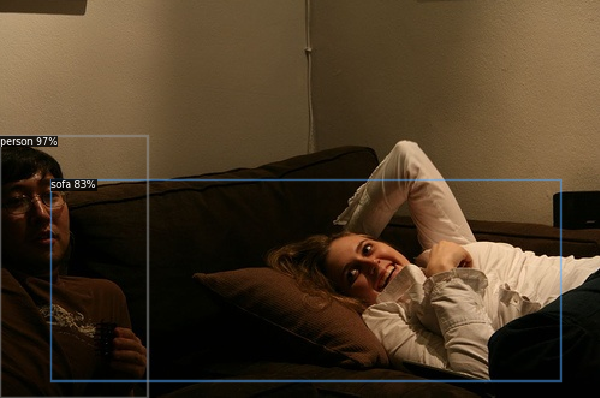

------------------------------------------------------------------------------------------


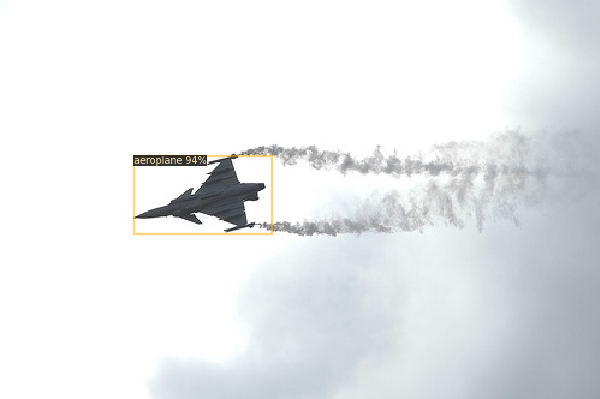

------------------------------------------------------------------------------------------


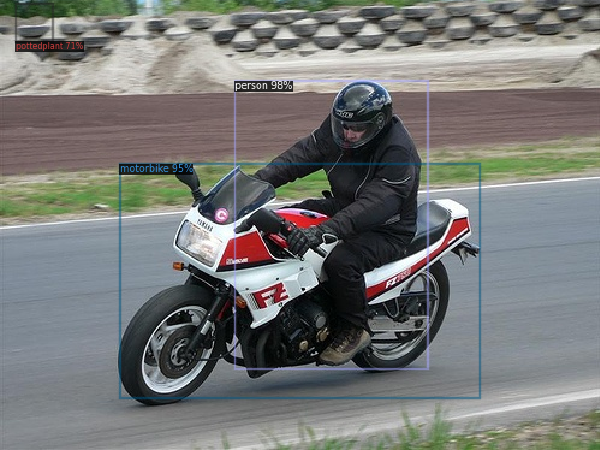

------------------------------------------------------------------------------------------


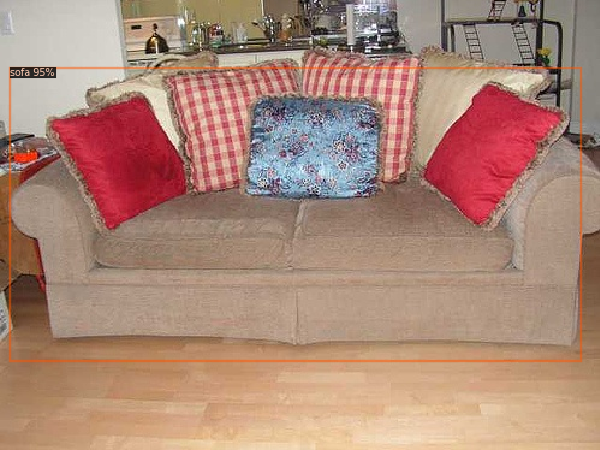

------------------------------------------------------------------------------------------


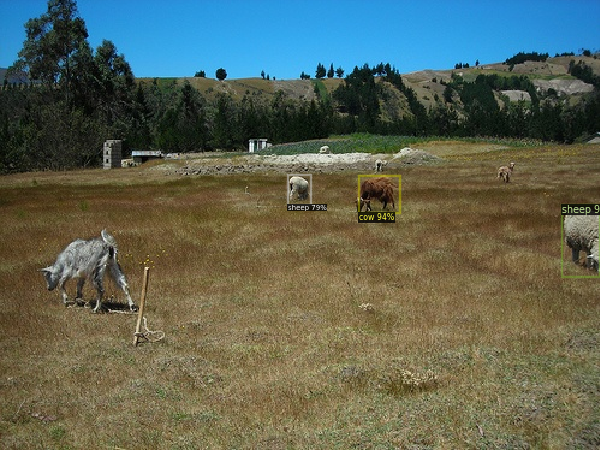

In [15]:
# We can use `Visualizer` to draw the predictions on the image.

cfg_fastrcnn.MODEL.WEIGHTS = os.path.join(cfg_fastrcnn.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg_fastrcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg_fastrcnn)

valimages_metadata_dict =MetadataCatalog.get("voc_2007_val")
valimages_dataset_dict = DatasetCatalog.get("voc_2007_val")

for fname in random.sample(valimages_dataset_dict,5):
    print("-"*90)
    #path = os.path.join(dirpath, )
    im = cv2.imread(fname['file_name'])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

    v = Visualizer(im[:, :, ::-1], valimages_metadata_dict, scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])



## Setting Configurations for Retina Net 

In [16]:
cfg_retinanet = get_cfg()
cfg_retinanet.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))
cfg_retinanet.OUTPUT_DIR = 'MyVOCTraining2'
cfg_retinanet.DATASETS.TRAIN = ("voc_2007_train",)
cfg_retinanet.DATASETS.TEST = ()
cfg_retinanet.DATALOADER.NUM_WORKERS = 2
cfg_retinanet.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_50_FPN_3x.yaml") # Let training initialize from model zoo
cfg_retinanet.SOLVER.IMS_PER_BATCH = 1
cfg_retinanet.SOLVER.BASE_LR = 0.00025 # pick a good LR
cfg_retinanet.SOLVER.MAX_ITER = 3000
cfg_retinanet.MODEL.RETINANET.BATCH_SIZE_PER_IMAGE = 128
cfg_retinanet.MODEL.RETINANET.NUM_CLASSES = 20

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


## Train the model

In [17]:
os.makedirs(cfg_retinanet.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg_retinanet) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/23 21:46:42 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_5bd44e.pkl: 152MB [00:14, 10.2MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (180, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (180,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
head.cls_score.{bias, weight}
The checkpoint state_dict contains keys that are not used by the model:
  pixel_mean
  pixel_std


[11/23 21:46:58 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[11/23 21:47:26 d2.utils.events]:  eta: 1:11:31  iter: 19  total_loss: 0.925  loss_cls: 0.7669  loss_box_reg: 0.1202  time: 1.4298  data_time: 0.0123  lr: 4.9953e-06  max_mem: 2672M
[11/23 21:47:42 d2.utils.events]:  eta: 1:03:48  iter: 39  total_loss: 1.362  loss_cls: 1.167  loss_box_reg: 0.2126  time: 1.0966  data_time: 0.0043  lr: 9.9902e-06  max_mem: 2711M
[11/23 21:47:56 d2.utils.events]:  eta: 0:38:00  iter: 59  total_loss: 0.9882  loss_cls: 0.825  loss_box_reg: 0.1461  time: 0.9603  data_time: 0.0042  lr: 1.4985e-05  max_mem: 2711M
[11/23 21:48:10 d2.utils.events]:  eta: 0:36:49  iter: 79  total_loss: 0.8348  loss_cls: 0.7828  loss_box_reg: 0.07275  time: 0.8889  data_time: 0.0041  lr: 1.998e-05  max_mem: 2711M
[11/23 21:48:23 d2.utils.events]:  eta: 0:36:02  iter: 99  total_loss: 0.9806  loss_cls: 0.7895  loss_box_reg: 0.1414  time: 0.8447  data_time: 0.0039  lr: 2.4975e-05  max_mem: 2711M
[11/23 21:48:37 d2.utils.events]:  eta: 0:34:52  iter: 119  total_loss: 0.8638  loss_cls:

## Load model weights into predictor

In [26]:
cfg_retinanet.MODEL.WEIGHTS = os.path.join(cfg_retinanet.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg_retinanet.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg_retinanet)

## Copy the output files to drive

In [27]:
cp -r MyVOCTraining2 /content/drive/MyDrive/CV/HW6/

In [20]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cp -r /content/drive/MyDrive/CV/HW6/MyVOCTraining MyVOCTraining

## Display on Tensorboard

In [30]:
%load_ext tensorboard
%tensorboard --logdir MyVOCTraining2/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Run Inference on dataset

In [25]:
from detectron2.evaluation import PascalVOCDetectionEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = PascalVOCDetectionEvaluator("voc_2007_val")
val_loader = build_detection_test_loader(cfg_retinanet, "voc_2007_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator)['bbox']['AP50'])

[11/23 22:39:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/23 22:39:13 d2.data.common]: Serializing 2510 elements to byte tensors and concatenating them all ...
[11/23 22:39:13 d2.data.common]: Serialized dataset takes 1.14 MiB
[11/23 22:39:13 d2.evaluation.evaluator]: Start inference on 2510 batches


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[11/23 22:39:17 d2.evaluation.evaluator]: Inference done 11/2510. Dataloading: 0.0018 s/iter. Inference: 0.3617 s/iter. Eval: 0.0002 s/iter. Total: 0.3636 s/iter. ETA=0:15:08
[11/23 22:39:22 d2.evaluation.evaluator]: Inference done 25/2510. Dataloading: 0.0022 s/iter. Inference: 0.3600 s/iter. Eval: 0.0003 s/iter. Total: 0.3629 s/iter. ETA=0:15:01
[11/23 22:39:27 d2.evaluation.evaluator]: Inference done 40/2510. Dataloading: 0.0025 s/iter. Inference: 0.3515 s/iter. Eval: 0.0003 s/iter. Total: 0.3547 s/iter. ETA=0:14:36
[11/23 22:39:32 d2.evaluation.evaluator]: Inference done 55/2510. Dataloading: 0.0025 s/iter. Inference: 0.3495 s/iter. Eval: 0.0003 s/iter. Total: 0.3525 s/iter. ETA=0:14:25
[11/23 22:39:38 d2.evaluation.evaluator]: Inference done 70/2510. Dataloading: 0.0025 s/iter. Inference: 0.3477 s/iter. Eval: 0.0003 s/iter. Total: 0.3507 s/iter. ETA=0:14:15
[11/23 22:39:43 d2.evaluation.evaluator]: Inference done 85/2510. Dataloading: 0.0024 s/iter. Inference: 0.3486 s/iter. Eval:

## Visualize the predictions 

------------------------------------------------------------------------------------------


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


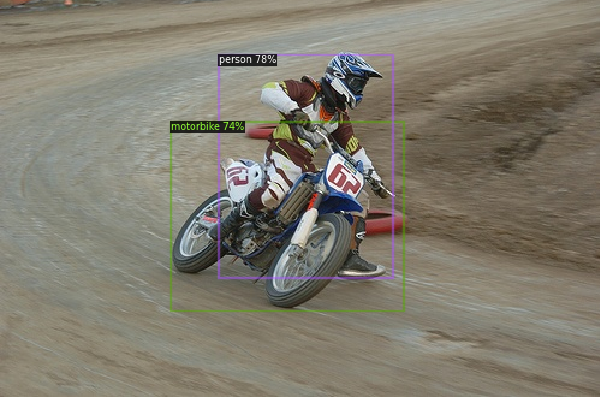

------------------------------------------------------------------------------------------


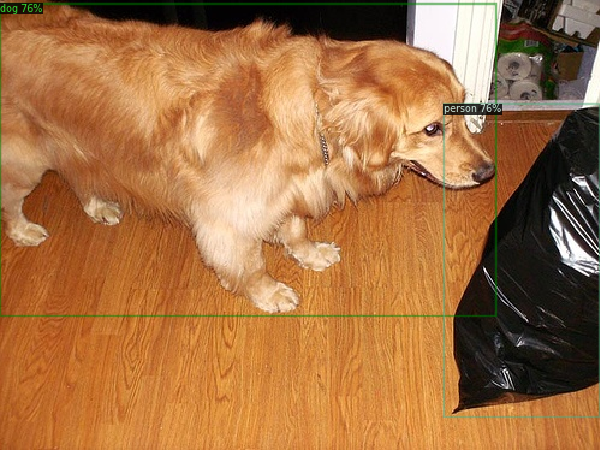

------------------------------------------------------------------------------------------


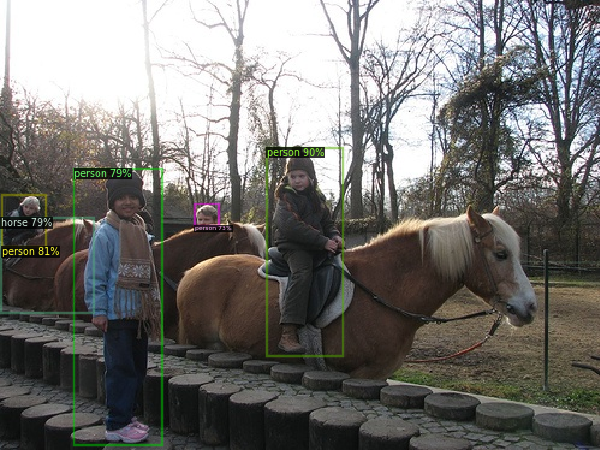

------------------------------------------------------------------------------------------


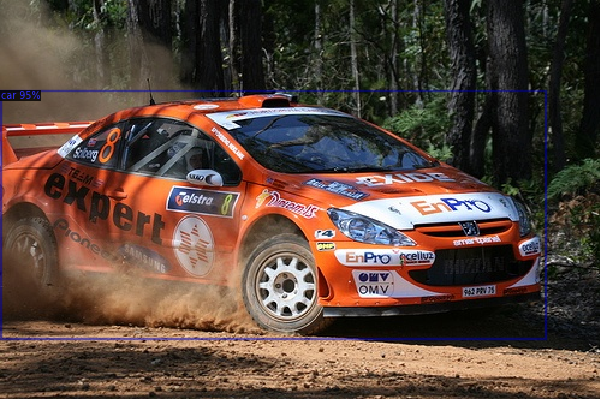

------------------------------------------------------------------------------------------


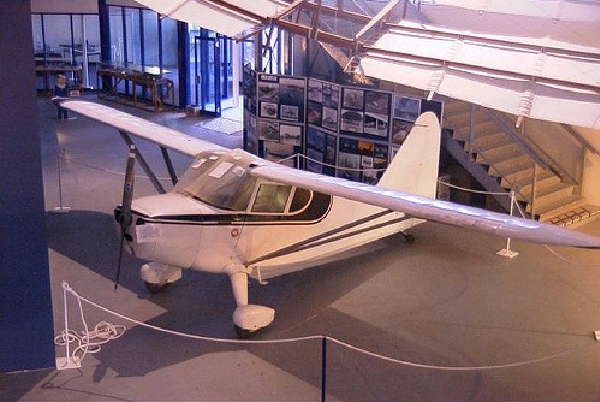

In [29]:
# We can use `Visualizer` to draw the predictions on the image.

cfg_retinanet.MODEL.WEIGHTS = os.path.join(cfg_retinanet.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg_retinanet.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg_retinanet)

valimages_metadata_dict =MetadataCatalog.get("voc_2007_val")
valimages_dataset_dict = DatasetCatalog.get("voc_2007_val")

for fname in random.sample(valimages_dataset_dict,5):
    print("-"*90)
    #path = os.path.join(dirpath, )
    im = cv2.imread(fname['file_name'])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

    v = Visualizer(im[:, :, ::-1], valimages_metadata_dict, scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])